In [141]:
from PIL import Image, ImageFilter, ImageEnhance, ImageOps
import os
import random
import numpy as np
import pandas as pd
from IPython.display import display

In [143]:
# Завдання 1

In [145]:
def analyze_images(folder_path):
    
    image_data = []
    
    for file_name in os.listdir(folder_path):
        file_path = os.path.join(folder_path, file_name)
        
        try:
            
            with Image.open(file_path) as img:
                
                file_info = {
                    "Ім'я файлу": file_name,
                    "Кольорова модель": img.mode,
                    "Формат": img.format,
                    "Кількість каналів": len(img.getbands()),
                    "Розмір файлу (МБ)": round(os.path.getsize(file_path) / (1024 * 1024), 2),
                    "Ширина (пікселів)": img.width,
                    "Висота (пікселів)": img.height,
                    "Повний шлях до файлу": file_path,
                    "Зображення": f'<img src="data:image/png;base64,{encode_image(file_path)}" width="100" height="100">'
                }
                image_data.append(file_info)
        except Exception as e:
            
            print(f"Пропущено файл {file_name}: {e}")
    
    df = pd.DataFrame(image_data)
    return df

In [147]:
def encode_image(image_path):
    import base64
    with open(image_path, "rb") as img_file:
        encoded = base64.b64encode(img_file.read()).decode('utf-8')
    return encoded

In [149]:
folder_path = "/Users/md/Desktop/PL/py/PO/9LB"
df = analyze_images(folder_path)

Пропущено файл 16.txt: cannot identify image file '/Users/md/Desktop/PL/py/PO/9LB/16.txt'
Пропущено файл 17.txt: cannot identify image file '/Users/md/Desktop/PL/py/PO/9LB/17.txt'
Пропущено файл .DS_Store: cannot identify image file '/Users/md/Desktop/PL/py/PO/9LB/.DS_Store'


,Ім'я файлу,Кольорова модель,Формат,Кількість каналів,Розмір файлу (МБ),Ширина (пікселів),Висота (пікселів),Повний шлях до файлу,Зображення
0,8.jpg,RGB,JPEG,3,0.12,1200,630,/Users/md/Desktop/PL/py/PO/9LB/8.jpg,
1,9.jpg,RGB,JPEG,3,0.04,460,215,/Users/md/Desktop/PL/py/PO/9LB/9.jpg,
2,14.jpg,RGB,JPEG,3,0.08,616,353,/Users/md/Desktop/PL/py/PO/9LB/14.jpg,
3,15.jpg,RGB,JPEG,3,0.05,460,215,/Users/md/Desktop/PL/py/PO/9LB/15.jpg,
4,12.jpg,RGB,JPEG,3,0.14,956,538,/Users/md/Desktop/PL/py/PO/9LB/12.jpg,
5,13.jpg,RGB,JPEG,3,0.04,460,215,/Users/md/Desktop/PL/py/PO/9LB/13.jpg,
6,11.jpg,RGB,JPEG,3,0.04,460,215,/Users/md/Desktop/PL/py/PO/9LB/11.jpg,
7,10.jpg,RGB,JPEG,3,0.04,380,218,/Users/md/Desktop/PL/py/PO/9LB/10.jpg,
8,4.jpg,RGB,JPEG,3,0.04,460,215,/Users/md/Desktop/PL/py/PO/9LB/4.jpg,
9,5.jpg,RGB,JPEG,3,0.12,1083,609,/Users/md/Desktop/PL/py/PO/9LB/5.jpg,

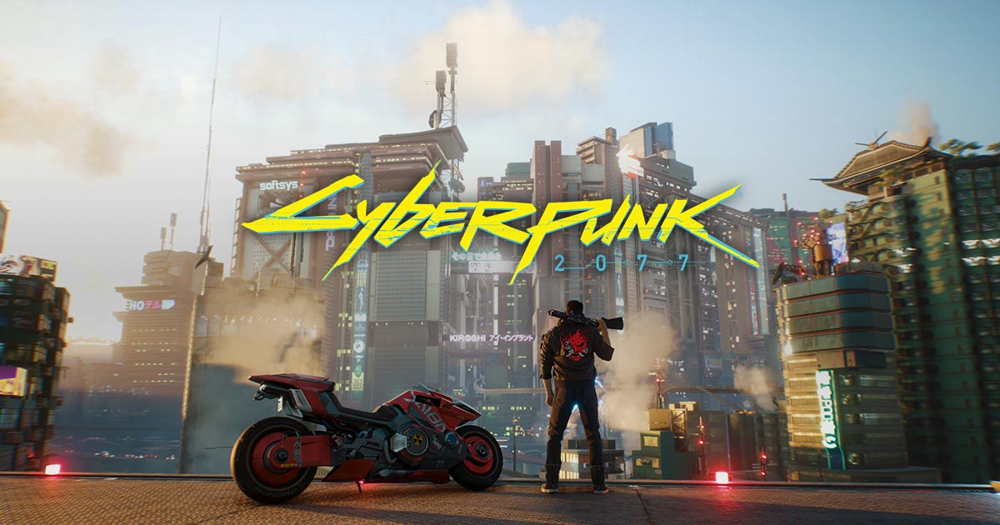
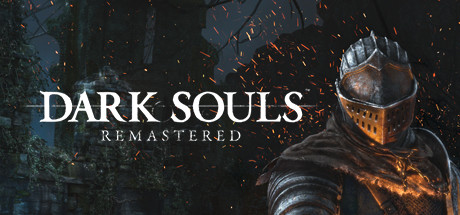
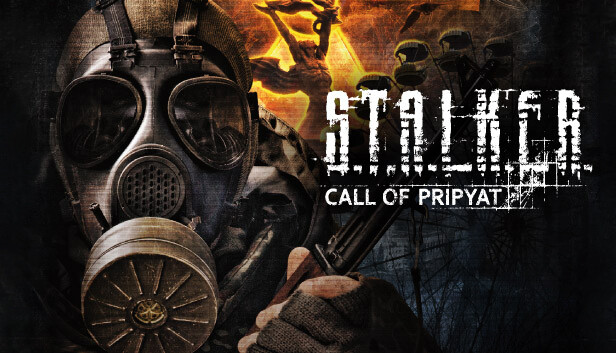
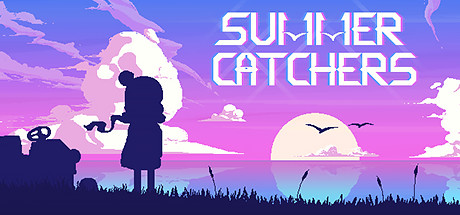
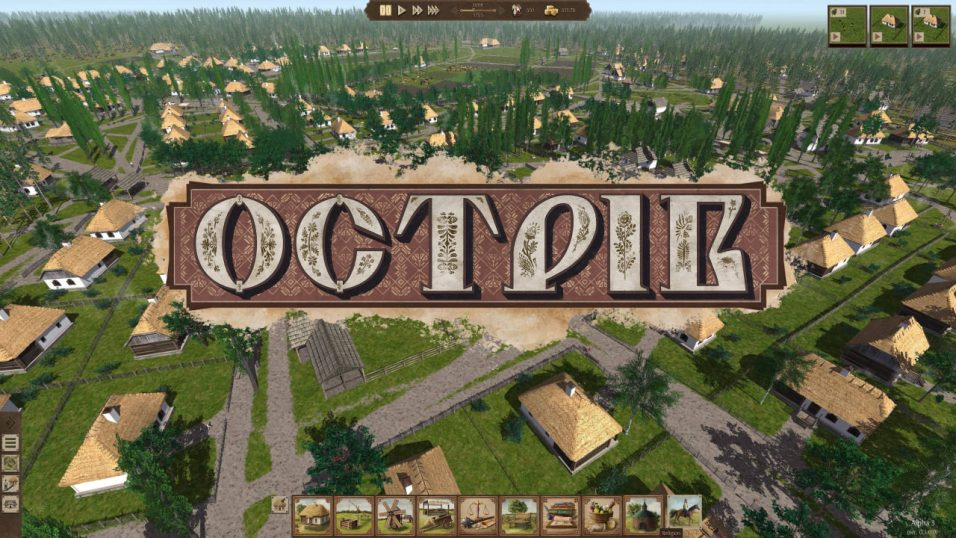
...
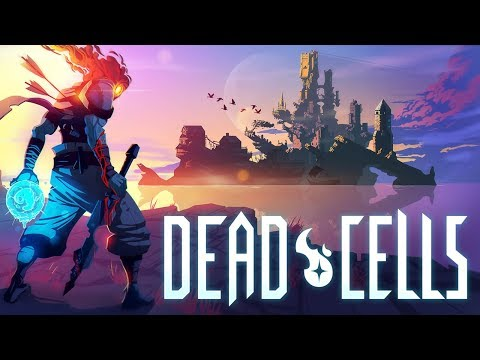
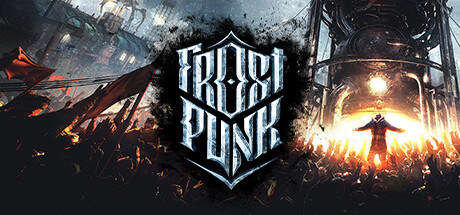
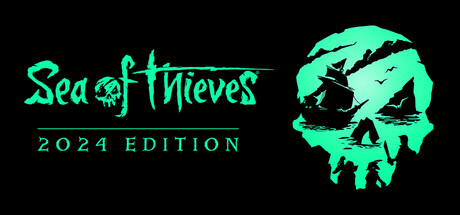
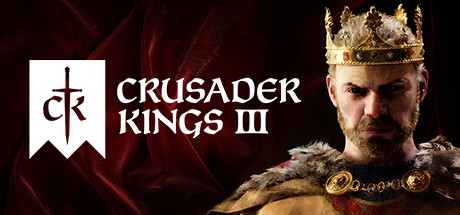
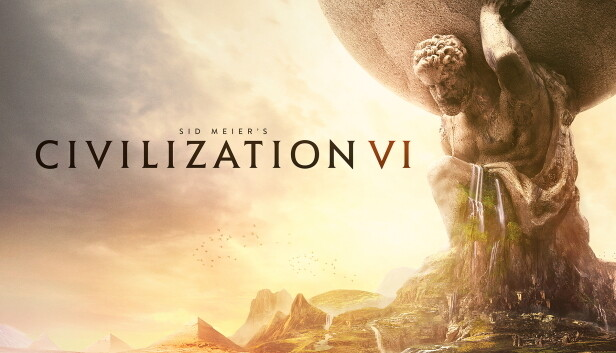

In [151]:
pd.set_option('display.max_colwidth', None)
display(HTML(df.to_html(escape=False)))

In [153]:
# Завдання 2

In [155]:
def crop_to_square(image):
    min_side = min(image.size)
    center_x, center_y = image.width // 2, image.height // 2
    left = center_x - min_side // 2
    upper = center_y - min_side // 2
    right = center_x + min_side // 2
    lower = center_y + min_side // 2
    return image.crop((left, upper, right, lower))

In [157]:
def apply_random_filter(image):
    filters = ['red', 'green', 'blue', 'yellow', 'magenta', 'cyan']
    chosen_filter = random.choice(filters)
    color_overlay = {
        'red': (255, 0, 0),
        'green': (0, 255, 0),
        'blue': (0, 0, 255),
        'yellow': (255, 255, 0),
        'magenta': (255, 0, 255),
        'cyan': (0, 255, 255)
    }[chosen_filter]
    
    overlay = Image.new('RGB', image.size, color_overlay)
    return Image.blend(image, overlay, alpha=0.3)

In [159]:
def create_poster(folder_path, output_name, num_rows, num_cols):
    
    images = [os.path.join(folder_path, file) for file in os.listdir(folder_path) if file.lower().endswith(('jpg', 'jpeg', 'png', 'bmp'))]
    
    if not images:
        raise ValueError("У папці немає зображень для створення постера!")
    
    selected_images = [Image.open(random.choice(images)) for _ in range(num_rows * num_cols)]
    
    processed_images = []
    for img in selected_images:
        img = crop_to_square(img) 
        img = img.resize((500, 500))  
        img = apply_random_filter(img)  
        processed_images.append(img)
    
    poster_width = num_cols * 500
    poster_height = num_rows * 500
    poster = Image.new('RGB', (poster_width, poster_height))
    
    for idx, img in enumerate(processed_images):
        x = (idx % num_cols) * 500
        y = (idx // num_cols) * 500
        poster.paste(img, (x, y))
    
    output_path = os.path.join(folder_path, output_name)
    poster.save(output_path)
    print(f"Постер збережено: {output_path}")
    return poster

In [161]:
folder_path = "/Users/md/Desktop/PL/py/PO/9LB"

In [163]:
poster_1 = create_poster(folder_path, "poster_1.jpg", 3, 3)
poster_2 = create_poster(folder_path, "poster_2.jpg", 4, 4)
poster_3 = create_poster(folder_path, "poster_3.jpg", 5, 5)

Постер збережено: /Users/md/Desktop/PL/py/PO/9LB/poster_1.jpg
Постер збережено: /Users/md/Desktop/PL/py/PO/9LB/poster_2.jpg
Постер збережено: /Users/md/Desktop/PL/py/PO/9LB/poster_3.jpg


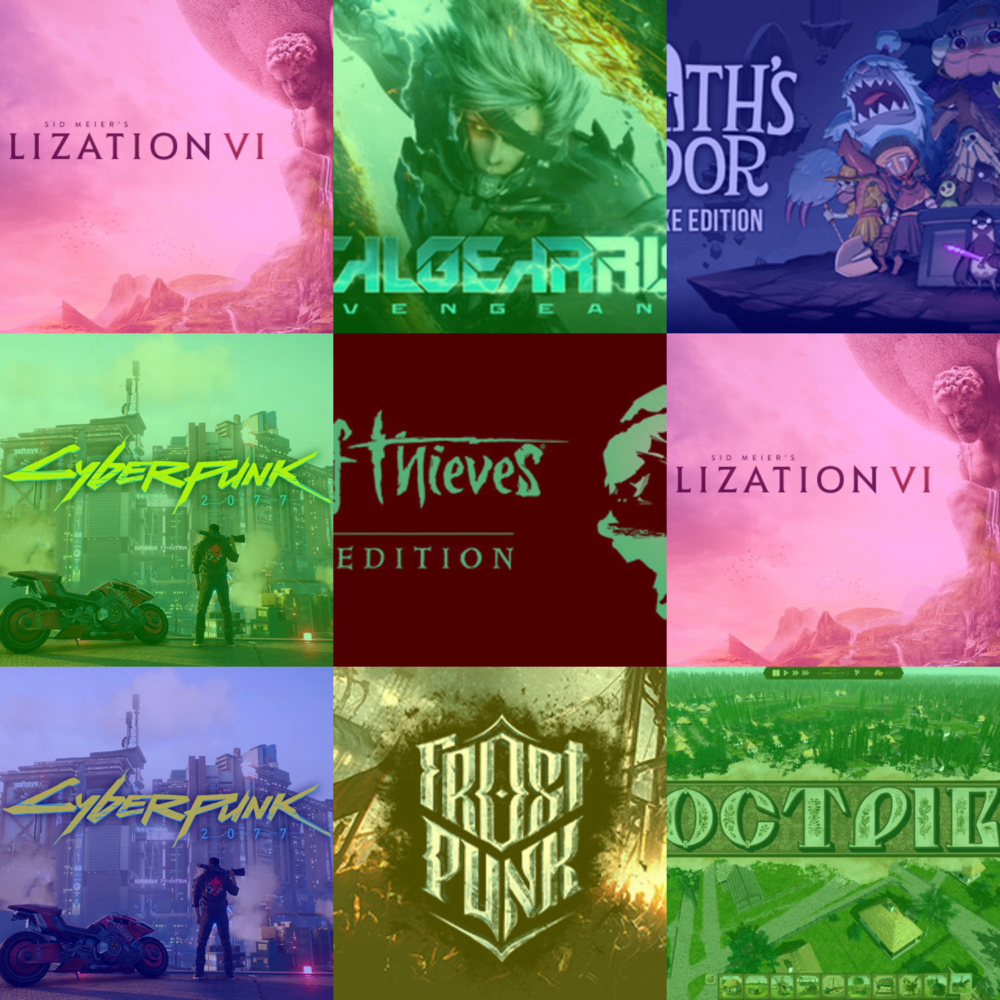

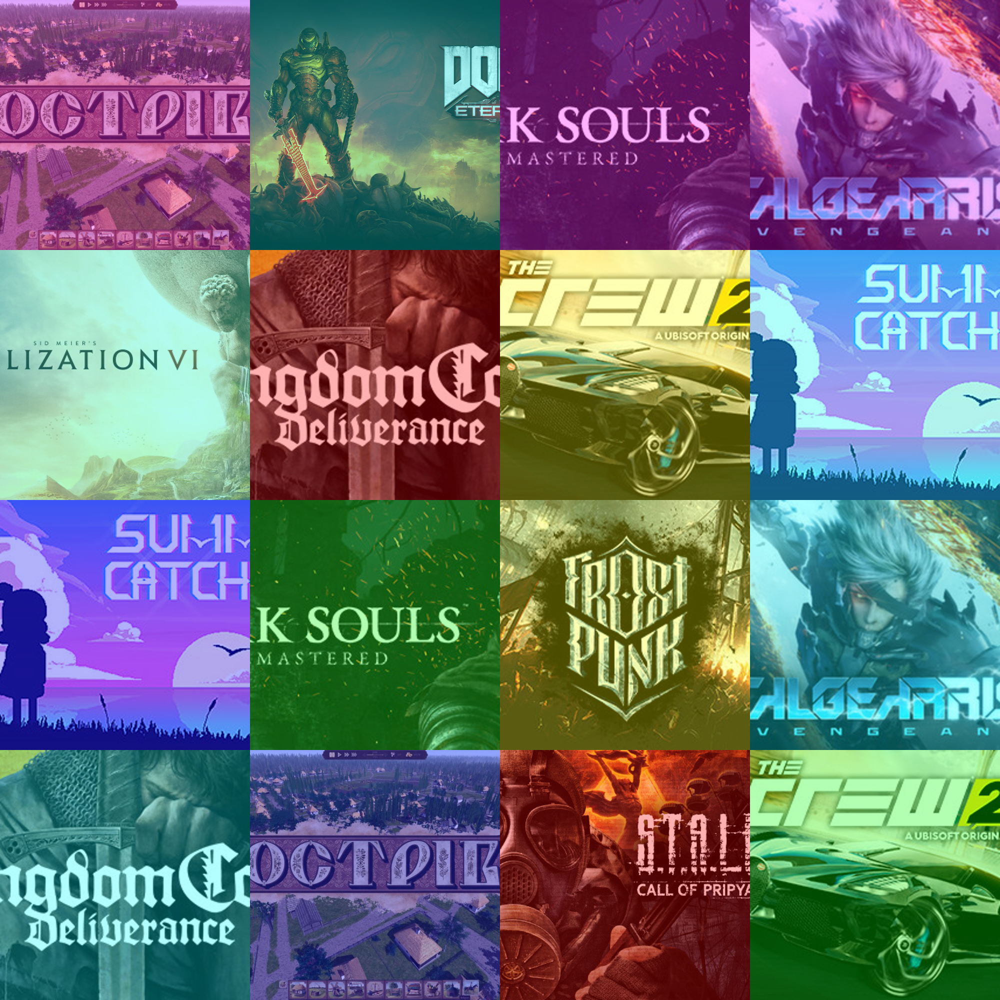

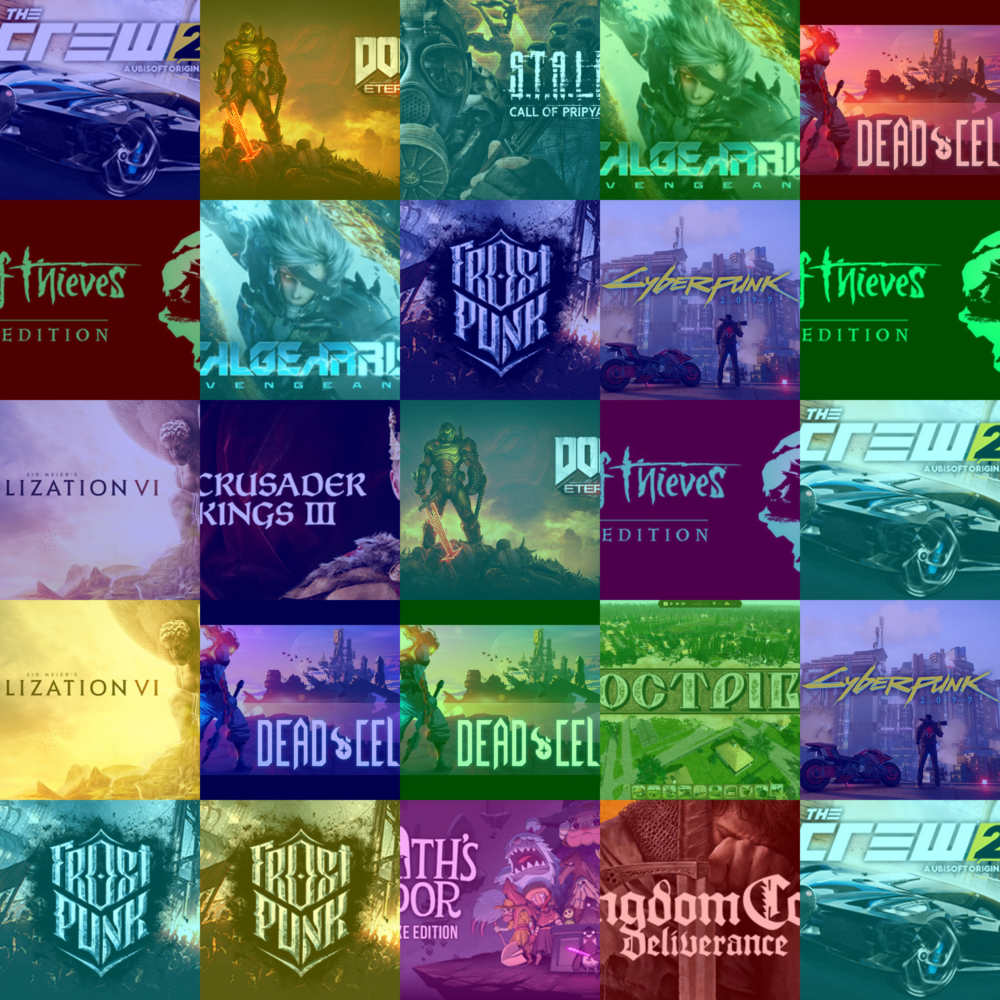

In [165]:
display(poster_1)
display(poster_2)
display(poster_3)